**Universitat Oberta Catalunya (UOC)**<br>
**Estudios de Informática, Multimedia y Telecomunicaciones**<br>
**Minería de datos: PEC2**<br>
**Autor: Víctor Luque Martín**<br>
**Fecha: Abril 2025**

# Contenidos

1. [Enunciado](#enunciado)
2. [Preparación Previa](#preparacion)
3. [Ejercicio 1](#ejercicio1)
    1. [Respuesta 1](#respuesta1)
3. [Ejercicio 2](#ejercicio2)
    1. [Respuesta 2](#respuesta2)
4. [Ejercicio 3](#ejercicio3)
    1. [Respuesta 3](#respuesta3)
5. [Bibliografía](#bibliografia)


# Enunciado <a class="anchor" id="enunciado"></a>
Los ejercicios se realizarán en base al juego de datos *Hawks* presente en el paquete R *Stat2Data*.  

Los estudiantes y el profesorado del Cornell College en Mount Vernon, Iowa, recogieron datos durante muchos años en el mirador de halcones del lago MacBride, cerca de Iowa City, en el estado de Iowa. El conjunto de datos que analizamos aquí es un subconjunto del conjunto de datos original, utilizando sólo aquellas especies para las que había más de 10 observaciones. Los datos se recogieron en muestras aleatorias de tres especies diferentes de halcones: Colirrojo, Gavilán y Halcón de Cooper.  

Hemos seleccionado este juego de datos por su parecido con el juego de datos *penguins* y por su potencial a la hora de aplicarle algoritmos de minería de datos no supervisados. 

```{r message= FALSE, warning=FALSE}
if (!require('Stat2Data')) install.packages('Stat2Data')
library(Stat2Data)
data("Hawks")
summary(Hawks)
```

# Preparación Previa <a class="anchor" id="preparacion"></a>

Dado que estamos trabajando con Python y no con R, es posible aprovechar R desde Python mediante la librería `rpy2` para poder descargar o ejecutar código R en nuestro código Python. Podemos instalar las librerías necesarias para ejecutar este notebook descomentando la siguiente celda:

In [1]:
!pip install rpy2 pandas seaborn matplotlib numpy scikit-learn plotly


[notice] A new release of pip is available: 24.2 -> 25.0.1
[notice] To update, run: python.exe -m pip install --upgrade pip


**Importante**: Para que funcione correctamente, es necesario:
1. Tener instalado R en el sistema. En caso de no tenerlo, se puede instalar desde la página oficial de [R](https://cran.r-project.org/).
2. Añadir la ruta de la instalación de R a la variable de entorno del sistema `R_HOME`. Por ejemplo, en Windows, la ruta de instalación por defecto es `C:\Program Files\R\R-X.Y.Z`, por lo que la variable de entorno `R_HOME` debería ser `C:\Program Files\R\R-X.Y.Z`.

In [2]:
# NOTA: Para usar rpy2 en un cuaderno de Jupyter es necesario definir la variable de entorno R_HOME y que apunte a la version de R correspondiente instalada en C:\Program Files\R\R-X.Y.Z

import rpy2.robjects as ro # Importa el modulo rpy2.robjects para ejecutar codigo de R en Python
from rpy2.robjects.packages import importr # Importa el modulo rpy2.robjects.packages para importar paquetes de R en Python
from rpy2.robjects import pandas2ri # Importa el modulo rpy2.robjects.pandas2ri para convertir objetos de R a objetos de Pandas
import pandas as pd
pandas2ri.activate() # Activa la conversion de objetos de R a objetos de Pandas

import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

Instalamos la librería Stat2Data de R e importamos el dataset Hawks:

In [3]:
rutils = importr('utils')
rutils.install_packages('Stat2Data')
Stat2Data = importr('Stat2Data')
ro.r('data(Hawks)')
# Convertir las columnas de factores a cadenas de texto en R
ro.r('fctr.cols <- sapply(Hawks, is.factor)')
ro.r('Hawks[, fctr.cols] <- sapply(Hawks[, fctr.cols], as.character)')
Hawks_r = ro.r('Hawks')
Hawks_r.head()

R[write to console]: Installing package into 'C:/Users/victo/AppData/Local/R/win-library/4.4'
(as 'lib' is unspecified)



--- Please select a CRAN mirror for use in this session ---


R[write to console]: trying URL 'https://cran.rediris.es/bin/windows/contrib/4.4/Stat2Data_2.0.0.zip'

R[write to console]: Content type 'application/zip'
R[write to console]:  length 1230517 bytes (1.2 MB)

R[write to console]: downloaded 1.2 MB




package 'Stat2Data' successfully unpacked and MD5 sums checked

The downloaded binary packages are in
	C:\Users\victo\AppData\Local\Temp\RtmpITtVkn\downloaded_packages


Month,Day,Year,...,WingPitFat,KeelFat,Crop
9,19,1992,...,NA_integer_,...,...
9,22,1992,,NA_integer_,,
9,23,1992,,NA_integer_,,
9,23,1992,,NA_integer_,,
9,27,1992,,NA_integer_,,
9,28,1992,,NA_integer_,,


Dado que el objecto `Hawks_r` es un objeto de tipo `rpy2.robjects.vectors.DataFrame` debemos considerar lo siguiente:
1. Convertirlo a un DataFrame de pandas para poder trabajar con él en Python. 
2. R para los datos categóricos trabaja internamente con un tipo de dato llamado `factor` que no es directamente compatible con Python, por lo que lo convertimos a un tipo de dato compatible.
3. Los datos integer de R que son NA en Python toman el valor `-2147483648`. Por lo que debemos convertirlos a NA.

In [4]:
# Convertir el objeto de R a un objeto de Pandas
hawks_df = pandas2ri.rpy2py(Hawks_r)
# Empty string to NaN
hawks_df = hawks_df.replace('', np.nan)
hawks_df = hawks_df.replace(' ', np.nan)
# Replace '-2147483648' with NaN
hawks_df = hawks_df.replace(-2147483648, np.nan)
hawks_df.head()

,Month,Day,Year,CaptureTime,ReleaseTime,BandNumber,Species,Age,Sex,Wing,Weight,Culmen,Hallux,Tail,StandardTail,Tarsus,WingPitFat,KeelFat,Crop
1,9,19,1992,13:30,NaN,877-76317,RT,I,NaN,385.0,920.0,25.7,30.1,219,NaN,NaN,NaN,NaN,NaN
2,9,22,1992,10:30,NaN,877-76318,RT,I,NaN,376.0,930.0,NaN,NaN,221,NaN,NaN,NaN,NaN,NaN
3,9,23,1992,12:45,NaN,877-76319,RT,I,NaN,381.0,990.0,26.7,31.3,235,NaN,NaN,NaN,NaN,NaN
4,9,23,1992,10:50,NaN,745-49508,CH,I,F,265.0,470.0,18.7,23.5,220,NaN,NaN,NaN,NaN,NaN
5,9,27,1992,11:15,NaN,1253-98801,SS,I,F,205.0,170.0,12.5,14.3,157,NaN,NaN,NaN,NaN,NaN


In [5]:
hawks_summary = hawks_df.describe().transpose()
hawks_summary['nulls'] = hawks_df.isnull().sum()
hawks_summary = hawks_summary.transpose()
hawks_summary

,Month,Day,Year,Wing,Weight,Culmen,Hallux,Tail,StandardTail,Tarsus,WingPitFat,KeelFat,Crop
count,908.000000,908.000000,908.000000,907.000000,898.000000,901.000000,902.000000,908.000000,571.000000,75.000000,77.000000,567.000000,565.000000
mean,9.842511,15.740088,1998.253304,315.637486,772.080178,21.801498,26.410865,198.831498,199.182137,71.950667,0.792208,2.184303,0.234540
std,0.685717,8.413164,3.454180,95.277591,462.311760,7.284175,17.734704,36.824403,38.197755,17.263204,0.878660,1.044073,0.461597
min,8.000000,1.000000,1992.000000,37.200000,56.000000,8.600000,9.500000,119.000000,115.000000,24.700000,0.000000,0.000000,0.000000
25%,9.000000,9.000000,1995.000000,202.000000,185.000000,12.800000,15.100000,160.000000,162.000000,55.600000,0.000000,2.000000,0.000000
50%,10.000000,16.000000,1999.000000,370.000000,970.000000,25.500000,29.400000,214.000000,215.000000,79.300000,1.000000,2.000000,0.000000
75%,10.000000,23.000000,2001.000000,390.000000,1120.000000,27.300000,31.400000,225.000000,226.000000,87.000000,1.000000,3.000000,0.250000
max,11.000000,31.000000,2003.000000,480.000000,2030.000000,39.200000,341.400000,288.000000,335.000000,94.000000,3.000000,4.000000,5.000000
nulls,0.000000,0.000000,0.000000,1.000000,10.000000,7.000000,6.000000,0.000000,337.000000,833.000000,831.000000,341.000000,343.000000


In [6]:
hawks_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 908 entries, 1 to 908
Data columns (total 19 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Month         908 non-null    int64  
 1   Day           908 non-null    int64  
 2   Year          908 non-null    int64  
 3   CaptureTime   907 non-null    object 
 4   ReleaseTime   65 non-null     object 
 5   BandNumber    906 non-null    object 
 6   Species       908 non-null    object 
 7   Age           908 non-null    object 
 8   Sex           332 non-null    object 
 9   Wing          907 non-null    float64
 10  Weight        898 non-null    float64
 11  Culmen        901 non-null    float64
 12  Hallux        902 non-null    float64
 13  Tail          908 non-null    int64  
 14  StandardTail  571 non-null    float64
 15  Tarsus        75 non-null     float64
 16  WingPitFat    77 non-null     float64
 17  KeelFat       567 non-null    float64
 18  Crop          565 non-null    float

En caso de no disponer de R en nuestro entorno es posible utilizar el dataset [Hawks.csv](https://github.com/vincentarelbundock/Rdatasets/blob/master/csv/Stat2Data/Hawks.csv) que se encuentra en el repositorio oficial de la librería Stat2Data en Github [https://github.com/vincentarelbundock/Rdatasets/blob/master/csv/Stat2Data/Hawks.csv](https://github.com/vincentarelbundock/Rdatasets/blob/master/csv/Stat2Data/Hawks.csv).

In [7]:
pd.read_csv('https://raw.githubusercontent.com/vincentarelbundock/Rdatasets/refs/heads/master/csv/Stat2Data/Hawks.csv', index_col=0)

,Month,Day,Year,CaptureTime,ReleaseTime,BandNumber,Species,Age,Sex,Wing,Weight,Culmen,Hallux,Tail,StandardTail,Tarsus,WingPitFat,KeelFat,Crop
rownames,,,,,,,,,,,,,,,,,,,
1,9,19,1992,13:30,NaN,877-76317,RT,I,NaN,385.0,920.0,25.7,30.1,219,NaN,NaN,NaN,NaN,NaN
2,9,22,1992,10:30,,877-76318,RT,I,NaN,376.0,930.0,NaN,NaN,221,NaN,NaN,NaN,NaN,NaN
3,9,23,1992,12:45,,877-76319,RT,I,NaN,381.0,990.0,26.7,31.3,235,NaN,NaN,NaN,NaN,NaN
4,9,23,1992,10:50,,745-49508,CH,I,F,265.0,470.0,18.7,23.5,220,NaN,NaN,NaN,NaN,NaN
5,9,27,1992,11:15,,1253-98801,SS,I,F,205.0,170.0,12.5,14.3,157,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
904,11,18,2003,14:44,,1177-04777,RT,I,NaN,380.0,1525.0,26.0,27.6,224,227.0,NaN,NaN,3.0,0.0
905,11,19,2003,10:18,,803-05985,SS,I,F,190.0,175.0,12.7,15.4,150,153.0,NaN,NaN,4.0,0.0
906,11,19,2003,12:02,,1807-53145,RT,I,NaN,360.0,790.0,21.9,27.6,211,215.0,NaN,NaN,2.0,0.0


# Ejercicio 1 <a class="anchor" id="ejercicio1"></a>

Presenta el juego de datos, nombre y significado de cada columna, así como las distribuciones de sus valores.  

Realiza un estudio aplicando el método K-means, similar al de los ejemplos 1 y 2.

## Respuesta 1 <a class="anchor" id="respuesta1"></a>

De acuerdo con la documentación oficial de la librería `Stat2Data`, el dataset `Hawks` contiene datos de una muestra de halcones realizada por estudiantes y profesores del Cornell College en Mount Vernon, Iowa. Los datos recogidos son un subconjunto del conjunto de datos original, utilizando sólo aquellas especies para las que había más de 10 observaciones. Los datos se recogieron en muestras aleatorias de tres especies diferentes de halcones: Colirrojo (RT), Gavilán (SS) y Halcón de Cooper (CH). Las columnas del dataset son las siguientes:
- **Month**: Mes de la observación.
- **Day**: Día de la observación.
- **Year**: Año de la observación.
- **CaptureTime**: Hora de la captura (HH:MM).
- **ReleaseTime**: Hora de la liberación (HH:MM).
- **BandNumber**: ID de anilla.
- **Species**: Especie de halcón (RT, SS o CH).
- **Age**: Edad del halcón (A=Adulto o I=Inmaduro).
- **Sex**: Sexo (F=Femenino o M=Masculino).
- **Wing**: Longitud (en mm) de la pluma primaria del ala desde la punta hasta la muñeca a la que se une.
- **Weight**: Peso (en gramos) del halcón.
- **Culmen**: Longitud (en mm) de la parte superior del pico desde la punta hasta la parte carnosa del ave.
- **Hallux**: Longitud (en mm) de la garra.
- **Tail**: Medida (en mm) relativa a la longitud de la cola (inventada en el MacBride Raptor Center).
- **StandardTail**: Longitud (en mm) de la cola.
- **Tarsus**: Longitud del hueso del pie (en mm).
- **WingPitFat**: Cantidad de grasa en la axila del ala.
- **KeelFat**: La cantidad de grasa en el esternón (medida por tacto).
- **Crop**: La cantidad de comida en el buche, oscilando entre 1=lleno y 0=vacío.

Como podemos intuir, este dataset puede ser utilizado para resolver un problema de clasificación multiclase, donde el objetivo sería predecir la especie de halcón a partir de las variables restantes. El propósito de aplicar un modelo de agregación sobre este juego de datos es el de identificar patrones, es decir, quisiéramos verificar si a partir de la caracterización de los halcones (mediciones diversas) es realmente posible establecer la especie a la que pertenecen.

Tras observar el resumen, observamos que en las columnas, `ReleaseTime`, `Sex`, `Tarsus`, `WingPitFat`, `KeelFat`, `Crop` observamos un gran número de valores nulos, calculemos el porcentaje de valores nulos en cada columna para determinar si es necesario realizar una limpieza de datos o una imputación de valores nulos.:

In [8]:
hawks_nulls = hawks_df.isnull().sum() / len(hawks_df)
hawks_nulls

Month           0.000000
Day             0.000000
Year            0.000000
CaptureTime     0.001101
ReleaseTime     0.928414
BandNumber      0.002203
Species         0.000000
Age             0.000000
Sex             0.634361
Wing            0.001101
Weight          0.011013
Culmen          0.007709
Hallux          0.006608
Tail            0.000000
StandardTail    0.371145
Tarsus          0.917401
WingPitFat      0.915198
KeelFat         0.375551
Crop            0.377753
dtype: float64

Procedemos a mostrar el histograma de cada columna del dataset para visualizar la distribución de sus valores. Comencemos con las variables numéricas.

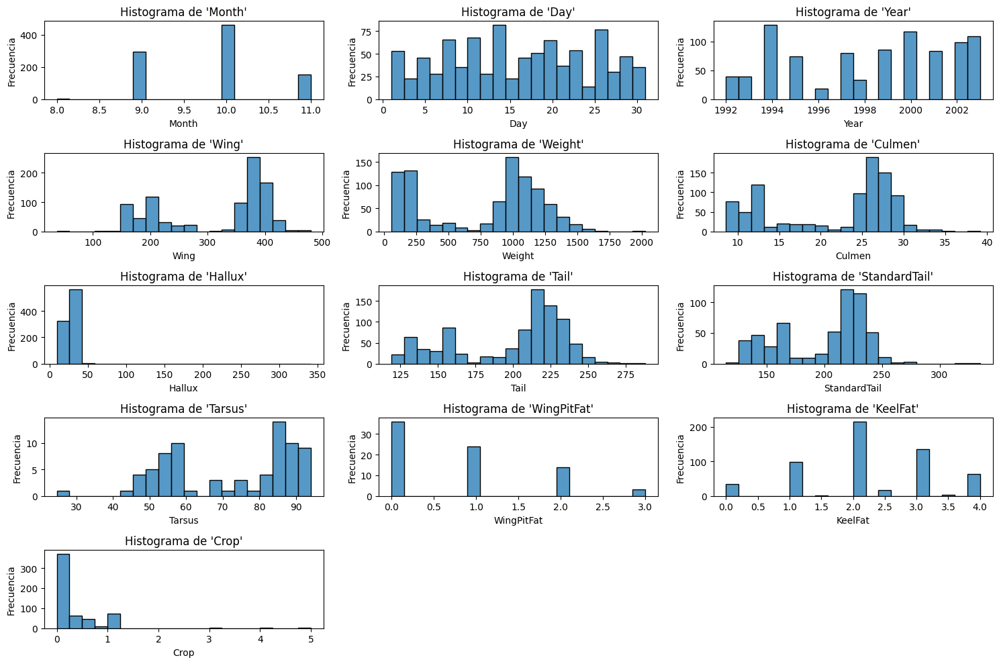

In [9]:
numeric_columns = hawks_df.select_dtypes(include=[np.number]).columns
# Generación de columnas y filas para los subgráficos
fig, ax = plt.subplots(nrows=len(numeric_columns)//3+1, ncols=3, figsize=(15, 10))

ax = ax.flatten()

for idx, col in enumerate(numeric_columns):
    sns.histplot(hawks_df[col].dropna(), ax=ax[idx], kde=False, bins=20)
    ax[idx].set_title(f"Histograma de '{col}'")
    ax[idx].set_xlabel(col)
    ax[idx].set_ylabel('Frecuencia')

# Eliminar subgráficos vacíos
for j in range(idx+1, len(ax)):
    fig.delaxes(ax[j])

plt.tight_layout()
plt.show()

Podemos observar algunos valores outliers, veamos con más detalle los outliers de cada columna numérica.

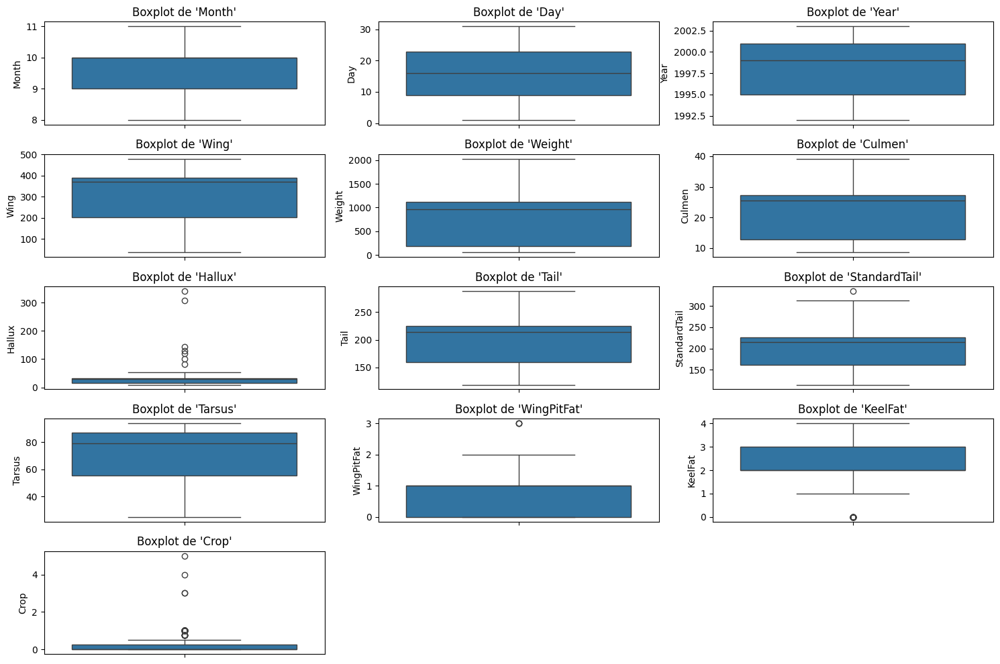

In [10]:
# boxplot por cada columna numérica
fig, ax = plt.subplots(nrows=len(numeric_columns)//3+1, ncols=3, figsize=(15, 10))

ax = ax.flatten()

for idx, col in enumerate(numeric_columns):
    sns.boxplot(y=hawks_df[col].dropna(), ax=ax[idx])
    ax[idx].set_title(f"Boxplot de '{col}'")
    ax[idx].set_ylabel(col)

# Eliminar subgráficos vacíos
for j in range(idx+1, len(ax)):
    fig.delaxes(ax[j])

plt.tight_layout()
plt.show()

In [11]:
q1 = hawks_df['Hallux'].quantile(.25)
q3 = hawks_df['Hallux'].quantile(.75)

lim_sup = q3 + 1.5*(q3-q1)
lim_inf = q1 - 1.5*(q3-q1)

hallux_outliers = hawks_df[(hawks_df['Hallux'] < lim_inf) | (hawks_df['Hallux'] > lim_sup)]
hallux_outliers['Hallux']

40     101.0
91     308.0
96     341.4
103    143.0
189     82.8
583    121.0
618    130.0
Name: Hallux, dtype: float64

Observamos valores Outliers en las siguientes columnas:
- `Crop`: Valores superiores a 1. Según la descripción del dataset, el valor de `Crop` debería oscilar entre 0 y 1. Deberemos eliminar los valores superiores a 1 o reemplazarlos por 1.
- `Hallux`: Contiene varios valores atípicos superiores a 82. Normalizaremos estos valores atípicos aplicando la media más adelante.
- `KeelFat`: Contiene varios valores atípicos con valor 0, al traterse de una medida por tacto, es posible que estos valores sean no correctos. No consideraremos estos valores.
- `StandardTail`: Contiene varios valores atípicos superiores a 300 mm.

A continuación, mostramos las variables categóricas:

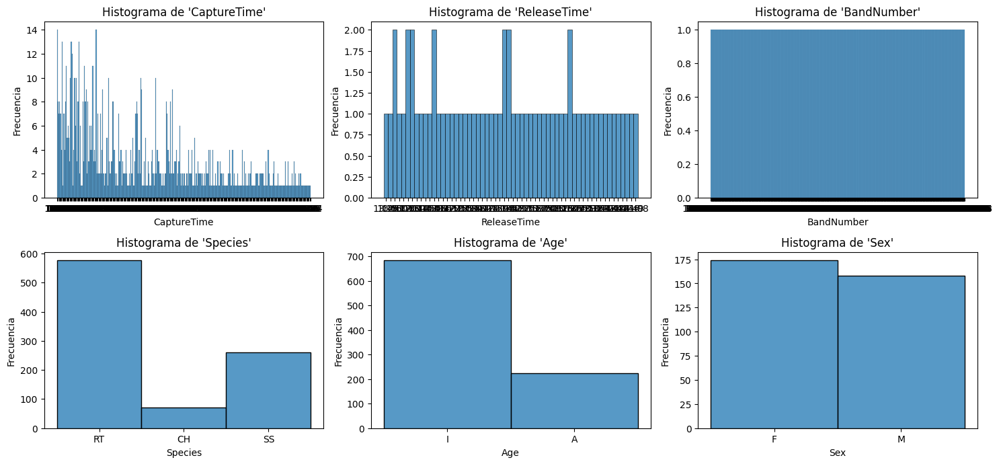

In [12]:
categorical_columns = hawks_df.select_dtypes(include=['object']).columns
# Generación de columnas y filas para los subgráficos
fig, ax = plt.subplots(nrows=len(categorical_columns)//3+1, ncols=3, figsize=(15, 10))

ax = ax.flatten()

for idx, col in enumerate(categorical_columns):
    sns.histplot(hawks_df[col], ax=ax[idx], kde=False, bins=20)
    ax[idx].set_title(f"Histograma de '{col}'")
    ax[idx].set_xlabel(col)
    ax[idx].set_ylabel('Frecuencia')

# Eliminar subgráficos vacíos
for j in range(idx+1, len(ax)):
    fig.delaxes(ax[j])

plt.tight_layout()
plt.show()

Observemos si los en función de la edad la especie de halcón es diferente. Para ello, realizamos un gráfico de barras de las características que nos interesan y que pueden ser relevantes para la clasificación de las especies de halcón (`Wing`, `Weight`, `Culmen`, `Hallux`, `Tail`, `Species`).

Analicemos si la característica `Age` es relevante para la clasificación de las especies de halcón.

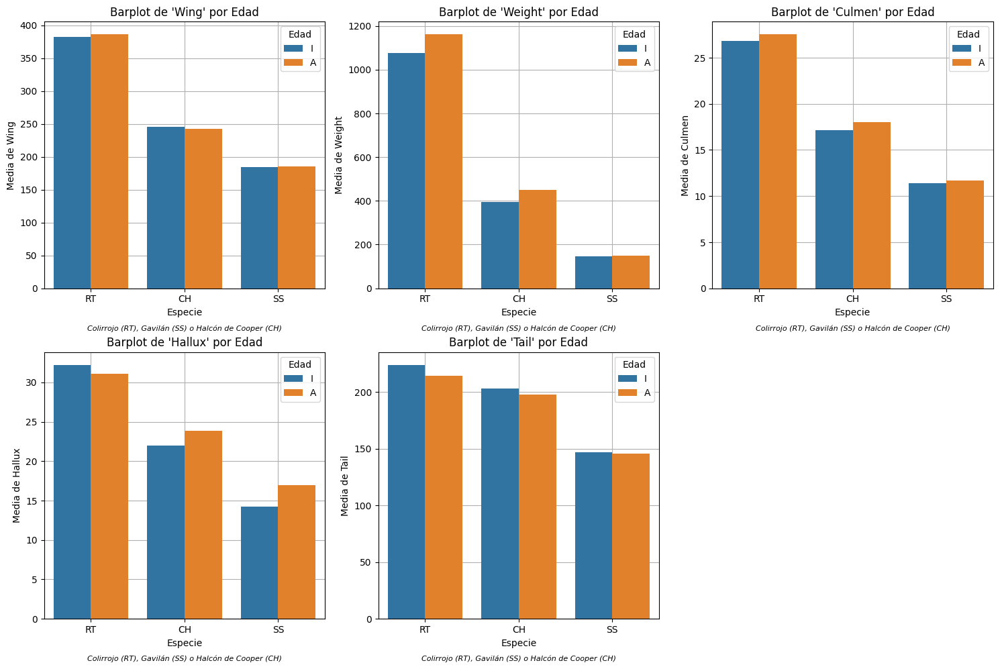

In [13]:
# barplot hue age

fig, ax = plt.subplots(nrows=2, ncols=3, figsize=(15, 10))

ax = ax.flatten()

for idx, col in enumerate(["Wing", "Weight", "Culmen", "Hallux", "Tail"]):
    sns.barplot(data=hawks_df, x='Species', y=col, hue='Age', ax=ax[idx], errorbar=None, zorder=2)
    ax[idx].set_title(f"Barplot de '{col}' por Edad")
    ax[idx].set_xlabel('Especie')
    ax[idx].set_ylabel(f'Media de {col}')
    ax[idx].legend(title='Edad')
    ax[idx].grid(True, zorder=1)
    # Add caption below the xaxis with text in italics
    ax[idx].text(0.5, -0.15, 'Colirrojo (RT), Gavilán (SS) o Halcón de Cooper (CH)', ha='center', va='center', transform=ax[idx].transAxes, style='italic', fontsize=8)

# Eliminar subgráficos vacíos
for j in range(idx+1, len(ax)):
    fig.delaxes(ax[j])

plt.tight_layout()
plt.show()

Observamos que no existe mucha diferencia en la media según la edad por lo que no parece que sea una variable relevante para la clasificación de las especies de halcón.

A partir de estos resultados y según la información de cada columna podemos concluir:
1. Trabajaremos únicamente con las columnas: `Wing`, `Weight`, `Culmen`, `Hallux`, `Tail` y `Species`. Eliminaremos el resto de columnas ya que no aportan información relevante para nuestro análisis.
2. Para las columnas que contienen valores nulos, aplicaremos la imputación de valores nulos con la media.
3. Imputaremos los valores outliers de la columna `Hallux` con la media según especie y edad
4. La columna `Species` es la variable objetivo.
5. Es necesario normalizar los datos para aplicar el algoritmo K-means, por lo que aplicaremos la normalización Min-Max a las columnas `Wing`, `Weight`, `Culmen`, `Hallux` y `Tail`.

Como hemos podido observar, el conjunto de datos con el que estamos trabajando no es del todo limpio por que realizamos una limpieza de los datos siguiendo las conclusiones obtenidas en el análisis anterior.

In [14]:
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import MinMaxScaler

# Selección de columnas
hawks_clean_df = hawks_df[['Wing', 'Weight', 'Culmen', 'Hallux', 'Tail', 'Species']].reset_index(drop=True)

numeric_columns = ['Wing', 'Weight', 'Culmen', 'Hallux', 'Tail']
# Imputación por la media
mean_imputer = SimpleImputer(strategy='mean')
hawks_clean_df[numeric_columns] = mean_imputer.fit_transform(hawks_clean_df[numeric_columns])

# Imputación de la media a los outliers de Hallux
hawks_clean_df.loc[hawks_clean_df['Hallux'] > 82, 'Hallux'] = np.nan
hawks_clean_df['Hallux'] = mean_imputer.fit_transform(hawks_clean_df[['Hallux']])

# Normalización de los datos numéricos utilizando MinMaxScaler
scaler = MinMaxScaler()
hawks_clean_df[numeric_columns] = scaler.fit_transform(hawks_clean_df[numeric_columns])

hawks_clean_df

C:\Users\victo\Documents\UOC\Ingeniería Informática\Minería de Datos\.venv\Lib\site-packages\numpy\_core\fromnumeric.py:86: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
C:\Users\victo\Documents\UOC\Ingeniería Informática\Minería de Datos\.venv\Lib\site-packages\numpy\_core\fromnumeric.py:86: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)


,Wing,Weight,Culmen,Hallux,Tail,Species
0,0.785456,0.437690,0.558824,0.457778,0.591716,RT
1,0.765131,0.442756,0.431422,0.375797,0.603550,RT
2,0.776423,0.473151,0.591503,0.484444,0.686391,RT
3,0.514453,0.209726,0.330065,0.311111,0.597633,CH
4,0.378952,0.057751,0.127451,0.106667,0.224852,SS
...,...,...,...,...,...,...
903,0.774164,0.744174,0.568627,0.402222,0.621302,RT
904,0.345077,0.060284,0.133987,0.131111,0.183432,SS
905,0.728997,0.371834,0.434641,0.402222,0.544379,RT
906,0.749322,0.407295,0.542484,0.411111,0.520710,RT


Una vez visualizados los histogramas de las variables numéricas y categóricas y limpiado el dataset, procedemos a aplicar el método K-means sobre las columnas `Wing`, `Weight`, `Culmen`, `Hallux` y `Tail` para identificar patrones en los datos. Suponiendo que inicialmente no conocemos el número de clusters, aplicaremos el método del codo, el criterio de Silhoutte y el criterio de Calinski-Harabasz para determinar el número óptimo de clusters.

Haremos uso de la librería `scikit-learn` para aplicar el método de K-means para visualizar los resultados posteriormente.

C:\Users\victo\Documents\UOC\Ingeniería Informática\Minería de Datos\.venv\Lib\site-packages\joblib\externals\loky\backend\context.py:136: UserWarning: Could not find the number of physical cores for the following reason:
[WinError 2] El sistema no puede encontrar el archivo especificado
Returning the number of logical cores instead. You can silence this warning by setting LOKY_MAX_CPU_COUNT to the number of cores you want to use.
  warnings.warn(
  File "C:\Users\victo\Documents\UOC\Ingeniería Informática\Minería de Datos\.venv\Lib\site-packages\joblib\externals\loky\backend\context.py", line 257, in _count_physical_cores
    cpu_info = subprocess.run(
               ^^^^^^^^^^^^^^^
  File "C:\Users\victo\AppData\Local\Programs\Python\Python312\Lib\subprocess.py", line 548, in run
    with Popen(*popenargs, **kwargs) as process:
         ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\victo\AppData\Local\Programs\Python\Python312\Lib\subprocess.py", line 1026, in __init__
    self._execu

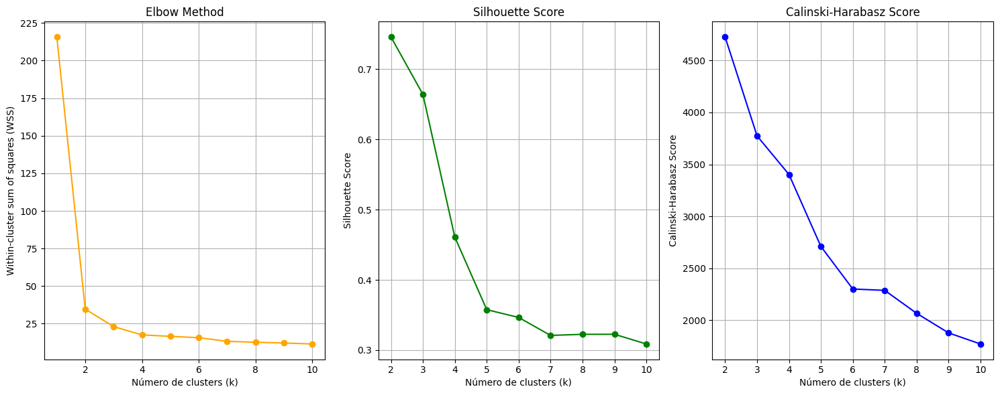

In [15]:
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score, calinski_harabasz_score

# Método del codo (Elbow Method)
max_k = 10
wss = []
relevant_columns = ['Wing', 'Weight', 'Culmen', 'Hallux', 'Tail']

# Renombrar las columnas para evitar problemas con los nombres de las columnas
hawks_clean_df = hawks_clean_df.rename(str, axis='columns')

# Considerar solo las columnas relevantes para el clustering
X = hawks_clean_df[relevant_columns].values

# Aplicar el método del codo
for k in range(1, max_k + 1): 
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(X)
    wss.append(kmeans.inertia_)  # Suma de los cuadrados dentro de los clústers


# Método silhoutte
silhouettes = []

for k in range(2, max_k + 1): # Range comienza en 2 porque el método silhoutte no se puede calcular con un solo cluster
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(X)
    silhouettes.append(silhouette_score(X, kmeans.labels_))

# Método Calinski-Harabasz
calinski_harabasz = []

for k in range(2, max_k + 1): # Range comienza en 2 porque el método silhoutte no se puede calcular con un solo cluster
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(X)
    calinski_harabasz.append(calinski_harabasz_score(X, kmeans.labels_))

# Graficar el método del codo
plt.figure(figsize=(15, 6))
plt.subplot(1, 3, 1)
plt.plot(range(1, max_k + 1), wss, marker='o', color='orange')
plt.title("Elbow Method")
plt.xlabel("Número de clusters (k)")
plt.ylabel("Within-cluster sum of squares (WSS)")
plt.grid(True)


# Graficar el método silhoutte
plt.subplot(1, 3, 2)
plt.plot(range(2, max_k + 1), silhouettes, marker='o', color="green")
plt.title("Silhouette Score")
plt.xlabel("Número de clusters (k)")
plt.ylabel("Silhouette Score")
plt.grid(True)

# Graficar el método Calinski-Harabasz
plt.subplot(1, 3, 3)
plt.plot(range(2, max_k + 1), calinski_harabasz, marker='o', color="blue")
plt.title("Calinski-Harabasz Score")
plt.xlabel("Número de clusters (k)")
plt.ylabel("Calinski-Harabasz Score")
plt.grid(True)

plt.tight_layout()
plt.show()


Podemos observar los siguientes resultados:
- El método del codo nos indica que el número óptimo de clusters es 2 o 3, ya que a partir de este punto la inercia disminuye de forma más suave.
- El criterio de silhoutte nos indica que el número óptimo de clusters es 2, ya que es el valor más alto obtenido (aprox. 0.80).
- El criterio de Calinski-Harabasz nos indica que el número óptimo de clusters es 2, ya que es el valor más alto obtenido (+4500).

Ninguno de los tres métodos nos da un resultado claro, ya que, inicialmente el dataset estaba compuesto por 3 clases, el método del codo nos indica 2 o 3 y el de silhouette y Calinksi-Harabasz 2. A continuación, aplicaremos el algoritmo K-Means con 2 y 3 clusters para comparar los resultados obtenidos, para eso comparamos visualmente los campos dos a dos. Posteriormente, compararemos los resultados obtenidos con la especie real de los halcones.

Primero agregamos el número de cluster al dataset y luego visualizamos los resultados de los clusters obtenidos con k=2 y k=3 clusters.

In [16]:
kmeans_2 = KMeans(n_clusters=2, random_state=42)
kmeans_2.fit(X)
kmeans_3 = KMeans(n_clusters=3, random_state=42)
kmeans_3.fit(X)

hawks_clean_df['Cluster (k=2)'] = kmeans_2.labels_
hawks_clean_df['Cluster (k=3)'] = kmeans_3.labels_
hawks_clean_df['Cluster (k=2)'] = hawks_clean_df['Cluster (k=2)'].astype(str)
hawks_clean_df['Cluster (k=3)'] = hawks_clean_df['Cluster (k=3)'].astype(str)
hawks_clean_df

,Wing,Weight,Culmen,Hallux,Tail,Species,Cluster (k=2),Cluster (k=3)
0,0.785456,0.437690,0.558824,0.457778,0.591716,RT,1,1
1,0.765131,0.442756,0.431422,0.375797,0.603550,RT,1,1
2,0.776423,0.473151,0.591503,0.484444,0.686391,RT,1,1
3,0.514453,0.209726,0.330065,0.311111,0.597633,CH,1,2
4,0.378952,0.057751,0.127451,0.106667,0.224852,SS,0,0
...,...,...,...,...,...,...,...,...
903,0.774164,0.744174,0.568627,0.402222,0.621302,RT,1,1
904,0.345077,0.060284,0.133987,0.131111,0.183432,SS,0,0
905,0.728997,0.371834,0.434641,0.402222,0.544379,RT,1,1
906,0.749322,0.407295,0.542484,0.411111,0.520710,RT,1,1


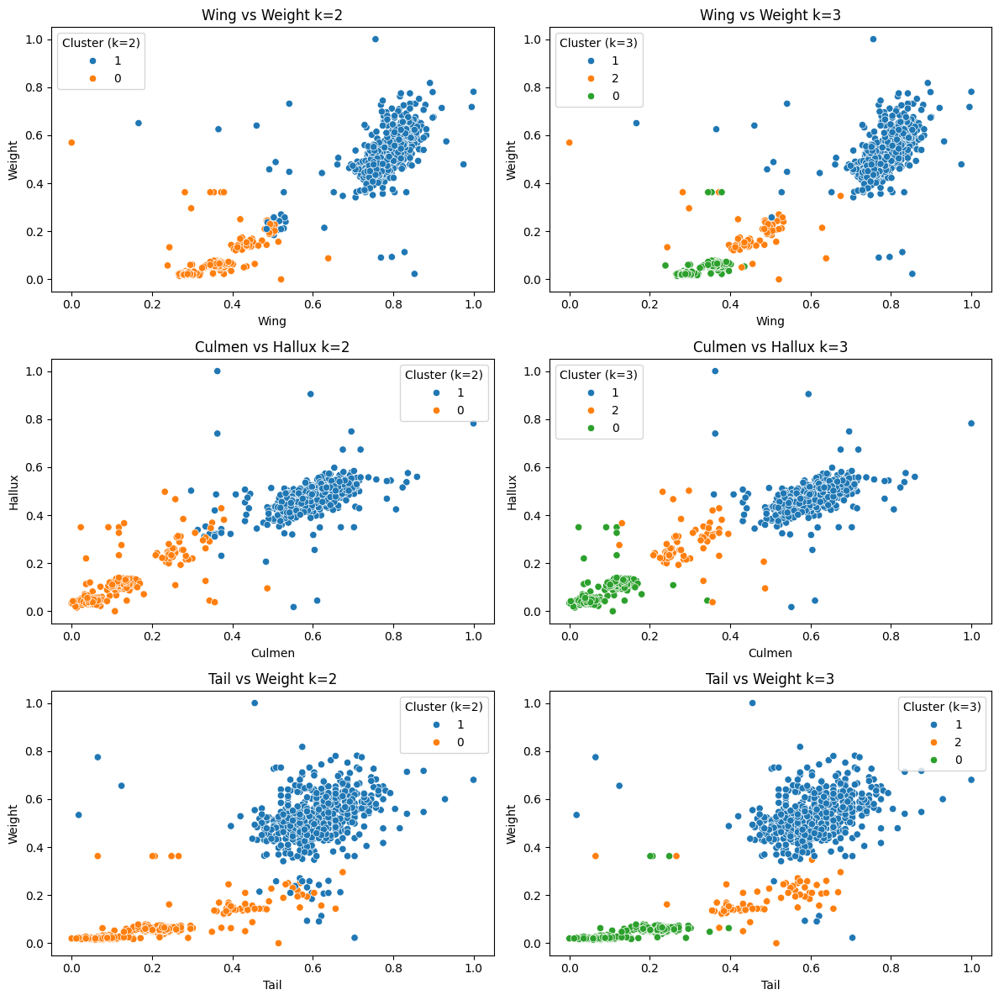

In [17]:
# Creación de subplots
fig, ax = plt.subplots(nrows=3, ncols=2, figsize=(12, 12))
ax = ax.flatten()

# Primer subplot
sns.scatterplot(data=hawks_clean_df, x='Wing', y='Weight', hue='Cluster (k=2)', palette='tab10', ax=ax[0])
ax[0].set_title("Wing vs Weight k=2")
ax[0].set_xlabel("Wing")
ax[0].set_ylabel("Weight")

# Segundo subplot
sns.scatterplot(data=hawks_clean_df, x='Wing', y='Weight', hue='Cluster (k=3)', palette='tab10', ax=ax[1])
ax[1].set_title("Wing vs Weight k=3")
ax[1].set_xlabel("Wing")
ax[1].set_ylabel("Weight")

# Tercer subplot
sns.scatterplot(data=hawks_clean_df, x='Culmen', y='Hallux', hue='Cluster (k=2)', palette='tab10', ax=ax[2])
ax[2].set_title("Culmen vs Hallux k=2")
ax[2].set_xlabel("Culmen")
ax[2].set_ylabel("Hallux")

# Cuarto subplot
sns.scatterplot(data=hawks_clean_df, x='Culmen', y='Hallux', hue='Cluster (k=3)', palette='tab10', ax=ax[3])
ax[3].set_title("Culmen vs Hallux k=3")
ax[3].set_xlabel("Culmen")
ax[3].set_ylabel("Hallux")

# Quinto subplot
sns.scatterplot(data=hawks_clean_df, x='Tail', y='Weight', hue='Cluster (k=2)', palette='tab10', ax=ax[4])
ax[4].set_title("Tail vs Weight k=2")
ax[4].set_xlabel("Tail")
ax[4].set_ylabel("Weight")

# Sexto subplot
sns.scatterplot(data=hawks_clean_df, x='Tail', y='Weight', hue='Cluster (k=3)', palette='tab10', ax=ax[5])
ax[5].set_title("Tail vs Weight k=3")
ax[5].set_xlabel("Tail")
ax[5].set_ylabel("Weight")

plt.tight_layout()
plt.show()

Procedemos a continuación a visualizar los resultados de los clusteres en 3D haciendo uso de la librería `plotly` para representar mejor los gráficos en 3D en el cuader

In [18]:
# Función de ayuda para generar las distintas traces en el gráfico 3D con leyenda (Para comparar clusters y especies)
import plotly.graph_objects as go
import plotly.express as px

# Paleta de colores
colors = px.colors.qualitative.Plotly
# Especies únicas
species = hawks_clean_df['Species'].unique()

# Función para agregar trazas con control de leyenda
def add_traces(fig, df, x_col, y_col, z_col, cluster_col, row, col, show_legend=True):
    if cluster_col.lower() == "species":
        for i, specie in enumerate(species):
            mask = df['Species'] == specie
            fig.add_trace(
                go.Scatter3d(
                    x=df[mask][x_col],
                    y=df[mask][y_col],
                    z=df[mask][z_col],
                    mode='markers',
                    marker=dict(
                        size=5,
                        color=colors[i % len(colors)],
                        opacity=0.7
                    ),
                    name=specie,
                    legendgroup=specie,  # Agrupar por especie
                    showlegend=show_legend,  # Controlar visibilidad en leyenda
                    meta=[specie]  # Metadata para interactividad
                ),
                row=row, 
                col=col
            )
    else:
        clusters = sorted(df[cluster_col].unique())
        for cluster in clusters:
            cluster_int = int(cluster)
            mask = df[cluster_col] == cluster
            fig.add_trace(
                go.Scatter3d(
                    x=df[mask][x_col],
                    y=df[mask][y_col],
                    z=df[mask][z_col],
                    mode='markers',
                    marker=dict(
                        size=5,
                        color=colors[cluster_int % len(colors)],
                        opacity=0.7
                    ),
                    name=f'Cluster {cluster_int} ({cluster_col})',
                    legendgroup=f'{cluster_col}_{cluster_int}',
                    showlegend=show_legend
                ),
                row=row, 
                col=col
            )

In [19]:
from plotly.subplots import make_subplots

# Crear subplots 3x2
fig = make_subplots(
    rows=2, 
    cols=2,
    # Para representar 3 filas y 2 columnas con 3D scatter plot es necesario especificar el tipo scene en cada subplot
    specs=[
        [{'type': 'scene'}, {'type': 'scene'}],
        [{'type': 'scene'}, {'type': 'scene'}]
    ],
    subplot_titles=(
        "Wing-Weight-Culmen k=2", 
        "Culmen-Hallux-Tail k=2",
        "Wing-Weight-Culmen k=3", 
        "Culmen-Hallux-Tail k=3"
    ),
    vertical_spacing=0.1
)



# Primera columna (Wing-Weight-Culmen)
add_traces(fig, hawks_clean_df, 'Wing', 'Weight', 'Culmen', 'Cluster (k=2)', 1, 1)
add_traces(fig, hawks_clean_df, 'Wing', 'Weight', 'Culmen', 'Cluster (k=3)', 2, 1)

# Segunda columna (Culmen-Hallux-Tail)
add_traces(fig, hawks_clean_df, 'Culmen', 'Hallux', 'Tail', 'Cluster (k=2)', 1, 2)
add_traces(fig, hawks_clean_df, 'Culmen', 'Hallux', 'Tail', 'Cluster (k=3)', 2, 2)

# Configurar layout
fig.update_layout(
    title_text="Análisis 3D de Clusters de Halcones",
    legend=dict(
        title="Clusters",
        itemsizing='constant',
        x=1.05,  # Posición más a la derecha
        y=0.5,
        bgcolor='rgba(255,255,255,0.9)'
    ),
    margin=dict(r=200)  # Espacio para la leyenda
)

# Configurar ejes para columna izquierda (Wing-Weight-Culmen)
for row in [1, 2]:
    fig.update_scenes(
        xaxis_title='Wing',
        yaxis_title='Weight', 
        zaxis_title='Culmen',
        row=row, 
        col=1
    )

# Configurar ejes para columna derecha (Culmen-Hallux-Tail)
for row in [1, 2]:
    fig.update_scenes(
        xaxis_title='Culmen',
        yaxis_title='Hallux', 
        zaxis_title='Tail',
        row=row, 
        col=2
    )

fig.show()

Finalmente comparamos con los datos reales de Species para determinar si el algoritmo K-means ha sido capaz de identificar los patrones en los datos.

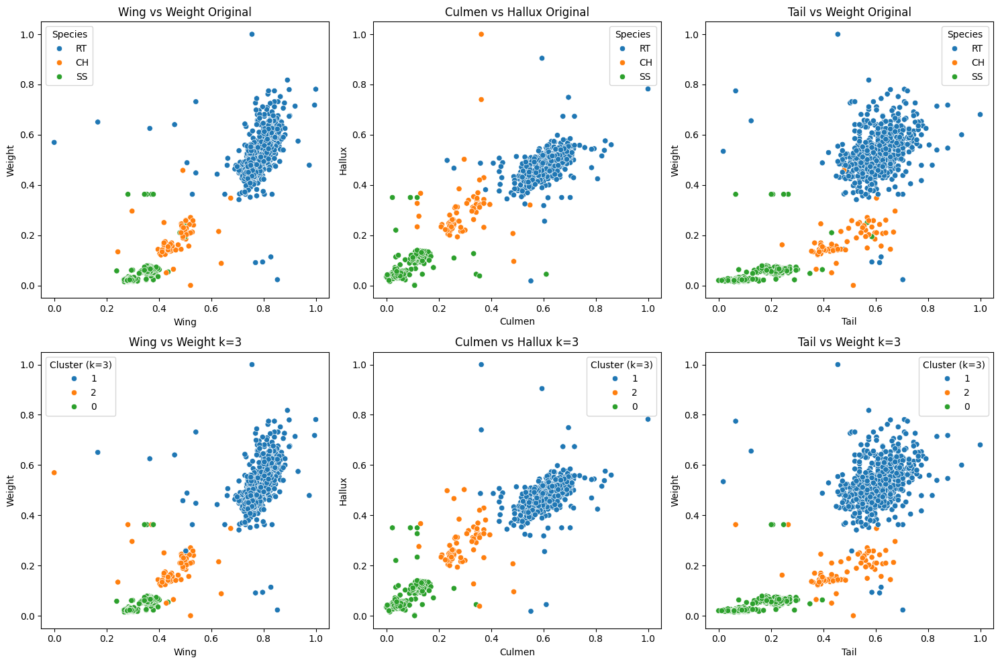

In [20]:
# Creación de los subplots
fig, ax = plt.subplots(nrows=2, ncols=3, figsize=(15, 10))

ax = ax.flatten()

# Primer subplot
sns.scatterplot(data=hawks_clean_df, x='Wing', y='Weight', hue='Species', palette='tab10', ax=ax[0])
ax[0].set_title("Wing vs Weight Original")
ax[0].set_xlabel("Wing")
ax[0].set_ylabel("Weight")

# Segundo subplot
sns.scatterplot(data=hawks_clean_df, x='Culmen', y='Hallux', hue='Species', palette='tab10', ax=ax[1])
ax[1].set_title("Culmen vs Hallux Original")
ax[1].set_xlabel("Culmen")
ax[1].set_ylabel("Hallux")

# Tercer subplot
sns.scatterplot(data=hawks_clean_df, x='Tail', y='Weight', hue='Species', palette='tab10', ax=ax[2])
ax[2].set_title("Tail vs Weight Original")
ax[2].set_xlabel("Tail")
ax[2].set_ylabel("Weight")

# Cuarto subplot
sns.scatterplot(data=hawks_clean_df, x='Wing', y='Weight', hue='Cluster (k=3)', palette='tab10', ax=ax[3])
ax[3].set_title("Wing vs Weight k=3")
ax[3].set_xlabel("Wing")
ax[3].set_ylabel("Weight")

# Quinto subplot
sns.scatterplot(data=hawks_clean_df, x='Culmen', y='Hallux', hue='Cluster (k=3)', palette='tab10', ax=ax[4])
ax[4].set_title("Culmen vs Hallux k=3")
ax[4].set_xlabel("Culmen")
ax[4].set_ylabel("Hallux")

# Sexto subplot
sns.scatterplot(data=hawks_clean_df, x='Tail', y='Weight', hue='Cluster (k=3)', palette='tab10', ax=ax[5])
ax[5].set_title("Tail vs Weight k=3")
ax[5].set_xlabel("Tail")
ax[5].set_ylabel("Weight")

plt.tight_layout()
plt.show()

Hacemos el mismo proceso que con los gráficos 3D para cada cluster, pero esta vez con los datos reales de Species.

In [21]:
fig = make_subplots(
    rows=2, 
    cols=2,
    specs=[
        [{'type': 'scene'}, {'type': 'scene'}],
        [{'type': 'scene'}, {'type': 'scene'}],
        ],
    subplot_titles=(
        "Wing vs Weight vs Culmen por Especie",
        "Culmen vs Hallux vs Tail por Especie",
        "Wing vs Weight vs Culmen por Cluster (k=3)",
        "Culmen vs Hallux vs Tail por Cluster (k=3)"
    ),
    horizontal_spacing=0.15
)

# Primer subplot (mostrar leyenda)
add_traces(fig, hawks_clean_df, 'Wing', 'Weight', 'Culmen', 'Species', 1, 1, show_legend=True)

# Segundo subplot (ocultar leyenda)
add_traces(fig, hawks_clean_df, 'Culmen', 'Hallux', 'Tail', 'Species', 1, 2, show_legend=False)

# Agregar trazas de los clusters (k=3) para el primer subplot
add_traces(fig, hawks_clean_df, 'Wing', 'Weight', 'Culmen', 'Cluster (k=3)', 2, 1, show_legend=True)
add_traces(fig, hawks_clean_df, 'Culmen', 'Hallux', 'Tail', 'Cluster (k=3)', 2, 2, show_legend=False)

# Configurar layout
fig.update_layout(
    title_text="Análisis 3D por Especie",
    legend=dict(
        title="Especies",
        itemsizing='constant',
        x=1.05,
        y=0.5,
        bgcolor='rgba(255,255,255,0.9)'
    ),
    margin=dict(r=200)
)

# Configurar ejes para columna izquierda (Wing-Weight-Culmen)
for row in [1, 2]:
    fig.update_scenes(
        xaxis_title='Wing',
        yaxis_title='Weight', 
        zaxis_title='Culmen',
        row=row, 
        col=1
    )

# Configurar ejes para columna derecha (Culmen-Hallux-Tail)
for row in [1, 2]:
    fig.update_scenes(
        xaxis_title='Culmen',
        yaxis_title='Hallux', 
        zaxis_title='Tail',
        row=row, 
        col=2
    )

fig.show()

Otra forma de comparar los resultados obtenidos sería utilizando el Análisis de Componenetes Principales (PCA) para reducir la dimensionalidad de los datos y visualizar los resultados en 3D. Para ello, aplicamos el PCA a los datos y visualizamos los resultados obtenidos con k=3 clusters.

In [22]:
from sklearn.decomposition import PCA

pca = PCA(n_components=3)
X_pca = pca.fit_transform(X)
# Agregar los resultados PCA al DataFrame
hawks_clean_df['PCA1'] = X_pca[:, 0]
hawks_clean_df['PCA2'] = X_pca[:, 1]
hawks_clean_df['PCA3'] = X_pca[:, 2]
hawks_clean_df.head()

,Wing,Weight,Culmen,Hallux,Tail,Species,Cluster (k=2),Cluster (k=3),PCA1,PCA2,PCA3
0,0.785456,0.437690,0.558824,0.457778,0.591716,RT,1,1,0.260650,0.027798,0.013950
1,0.765131,0.442756,0.431422,0.375797,0.603550,RT,1,1,0.165575,0.053223,-0.074280
2,0.776423,0.473151,0.591503,0.484444,0.686391,RT,1,1,0.341046,0.083715,0.008220
3,0.514453,0.209726,0.330065,0.311111,0.597633,CH,1,2,-0.133893,0.209855,0.004149
4,0.378952,0.057751,0.127451,0.106667,0.224852,SS,0,0,-0.605926,0.020935,-0.019668


Podemos comprobar si nuestros PCAs describen bien los datos:

In [23]:
ratios = pca.explained_variance_ratio_
eigenvalues = pca.explained_variance_
criterio_kaiser = eigenvalues > 1
varianza_acumulada = np.cumsum(ratios)

resumen_pca = pd.DataFrame({
    "Componente": [f"PC{i+1}" for i in range(len(ratios))],
    "Valor Propio": eigenvalues,
    "Varianza Explicada": ratios,
    "Varianza Acumulada": varianza_acumulada,
    "Varianza Explicada Kaiser": criterio_kaiser
})
resumen_pca


,Componente,Valor Propio,Varianza Explicada,Varianza Acumulada,Varianza Explicada Kaiser
0,PC1,0.222267,0.934813,0.934813,False
1,PC2,0.006829,0.028722,0.963535,False
2,PC3,0.003448,0.014503,0.978038,False


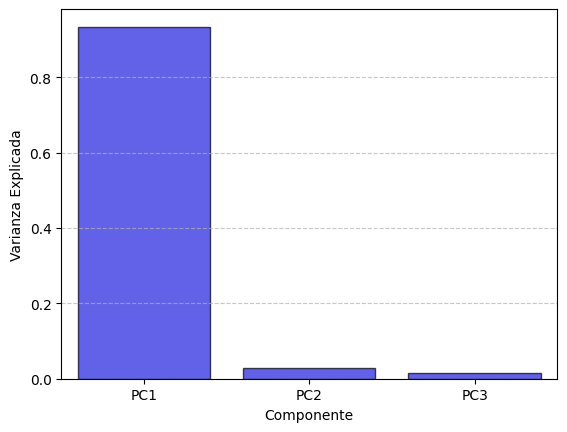

In [24]:
componentes = resumen_pca["Componente"]
varianza_explicada = resumen_pca["Varianza Explicada"]
sns.barplot(x=componentes, y=varianza_explicada, color="blue", edgecolor="black", alpha=0.7)
plt.grid(axis="y", linestyle="--", alpha=0.7)
plt.show()

Observamos que el componente principal 1 (PC1) explica un 93,48% de los datos, mientras que el componente principal 2 (PC2) explica, aproximadamente un 2,8% y finalmente el componente principal 3 (PC3) explica, aproximadamente un 1,5%. Por lo que podemos concluir que el PCA es capaz de describir el 97,8% de los datos. Por lo que podemos concluir que el PCA es capaz de describir el 97,8% de los datos.

In [25]:
fig = make_subplots(
    rows=1, 
    cols=2,
    specs=[
        [{'type': 'scene'}, {'type': 'scene'}],
        ],
    subplot_titles=(
        "PCA por Especie",
        "PCA por Cluster (k=3)"
    ),
    horizontal_spacing=0.15
)

# Primer subplot (mostrar leyenda)
add_traces(fig, hawks_clean_df, 'PCA1', 'PCA2', 'PCA3', 'Species', 1, 1, show_legend=True)
# Agregar trazas de los clusters (k=3) para el primer subplot
add_traces(fig, hawks_clean_df, 'PCA1', 'PCA2', 'PCA3', 'Cluster (k=3)', 1, 2, show_legend=True)

# Configurar layout
fig.update_layout(
    title_text="Comparación PCA Original vs K-Means 3D",
    legend=dict(
        title="Especies",
        itemsizing='constant',
        x=1.05,
        y=0.5,
        bgcolor='rgba(255,255,255,0.9)'
    ),
    margin=dict(r=200)
)

# Configurar ejes para columna izquierda (PCA1-PCA2-PCA3)
for row in [1, 2]:
    fig.update_scenes(
        xaxis_title='PCA1',
        yaxis_title='PCA2', 
        zaxis_title='PCA3',
        row=row, 
        col=1
    )

fig.show()


**Conclusiones:**
- El algoritmo K-means ha sido capaz de identificar varios patrones en los datos en función de las variables `Wing`, `Weight`, `Culmen`, `Hallux` y `Tail` y ha sido capaz de agrupar los datos en 2 y 3
- Observamos que existen un gran número de valores outliers tras la representación gráfica de los datos, lo que puede afectar a los resultados obtenidos por el algoritmo K-means.
- De acuerdo con los datos reales, el algoritmo K-means ha sido capaz de identificar gran parte de los datos en sus correspondientes grupos, no obstante, existen valores outliers que no han sido correctamente clasificados y que están teniendo un impacto en el modelo.
- Tras realizar el PCA observamos una mejor agrupación de los datos, comparandolo con los datos reales, ya que en los datos reales tenemos outlierss que pueden parecer que pertenecen a otro grupo, pero en realidad no es así.
- Según el análisis de PCA, el componente principal 1 describe un 93% de la varianza de los datos, lo que indica que el PCA ha sido capaz de reducir la dimensionalidad de los datos sin perder información relevante.

# Ejercicio 2 <a class="anchor" id="ejercicio2"></a>

Con el juego de datos proporcionado realiza un estudio aplicando DBSCAN y OPTICS, similar al del ejemplo 3.

## Respuesta 2 <a class="anchor" id="respuesta2"></a>

Haremos uso de nuestro dataset limpio y aplicaremos los algoritmos `DBSCAN` y `OPTICS` para identificar patrones en los datos. Estos algoritmos son algoritmos de agrupamiento basados en densidad que no requieren especificar el número de clusters a priori y son capaces de identificar clusters de forma arbitraria.
Para ello, utilizaremos la librería `scikit-learn` para aplicar los algoritmos.

In [26]:
hawks_clean_df.head()

,Wing,Weight,Culmen,Hallux,Tail,Species,Cluster (k=2),Cluster (k=3),PCA1,PCA2,PCA3
0,0.785456,0.437690,0.558824,0.457778,0.591716,RT,1,1,0.260650,0.027798,0.013950
1,0.765131,0.442756,0.431422,0.375797,0.603550,RT,1,1,0.165575,0.053223,-0.074280
2,0.776423,0.473151,0.591503,0.484444,0.686391,RT,1,1,0.341046,0.083715,0.008220
3,0.514453,0.209726,0.330065,0.311111,0.597633,CH,1,2,-0.133893,0.209855,0.004149
4,0.378952,0.057751,0.127451,0.106667,0.224852,SS,0,0,-0.605926,0.020935,-0.019668


Empezamos aplicando el algoritmo `DBSCAN` (Density-Based Spatial Clustering of Applications with Noise). Para ello, debemos especificar dos parámetros: `eps` y `min_samples`. El parámetro `eps` define la distancia máxima entre dos puntos para que se consideren parte del mismo cluster y `min_samples` define el número mínimo de puntos necesarios para formar un cluster. Estos hiperparámetros pueden calcularse de la siguiente forma:
- `eps`: Se puede calcular utilizando gráficos de distancias.
- `min_samples`: Como norma general se suele utilizar min_samples = 2 * n_features, donde `n_features` es el número de características del dataset. En nuestro caso, tenemos 5 características, por lo que `min_samples = 10`.

In [27]:
# Definmos X como los datos a clusterizar
X = hawks_clean_df[relevant_columns].values
# Definimos el mínimo de muestras para dbscan
dbscan_min_samples = 10

Para graficar el mejor valor para `eps` haremos uso de la función `NearestNeighbors` de la librería `scikit-learn` para calcular la distancia entre los puntos y graficar el resultado.

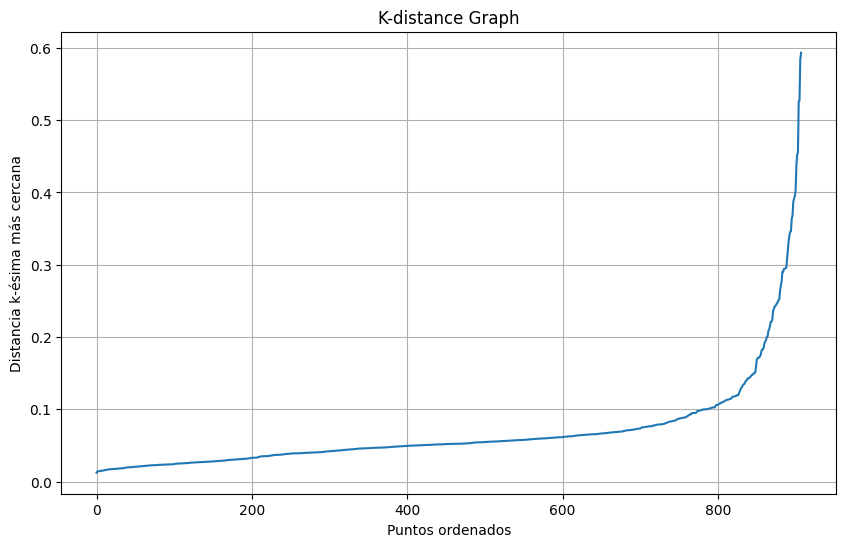

In [28]:
from sklearn.neighbors import NearestNeighbors

neighbours = NearestNeighbors(n_neighbors=dbscan_min_samples)
neighbours.fit(X)
distances, indices = neighbours.kneighbors(X)

sorted_distances = np.sort(distances[:, -1])
plt.figure(figsize=(10, 6))
plt.plot(sorted_distances, zorder=2)
plt.title("K-distance Graph")
plt.xlabel("Puntos ordenados")
plt.ylabel("Distancia k-ésima más cercana")
plt.grid(True, zorder=1)
plt.show()

Como podemos observar eb la gráfica de distancias, y aplicando la metodología del codo utilizada de forma similar para KMeans, en este caso, buscamos el valor de distancia que incrementa de forma más pronunciada. En nuestro caso, el valor óptimo de `eps` es 0.15, ya que a partir de este punto la distancia aumenta de forma más pronunciada. Por lo que aplicamos el algoritmo DBSCAN con los parámetros `eps=0.15` y `min_samples=10` y graficamos los resultados obtenidos.

Utilizaremos otro valor para `eps` para observar los resultados obtenidos. En este caso, aplicamos el algoritmo DBSCAN con los parámetros `eps=0.25` y `min_samples=10` y graficamos los resultados obtenidos.

In [29]:
from sklearn.cluster import DBSCAN

dbscan = DBSCAN(eps=0.15, min_samples=dbscan_min_samples)
clusters = dbscan.fit_predict(X)
hawks_clean_df['DBSCAN'] = clusters
hawks_clean_df['DBSCAN'] = hawks_clean_df['DBSCAN'].astype(str)
hawks_clean_df['DBSCAN'].value_counts()

DBSCAN
0     555
2     252
1      59
-1     42
Name: count, dtype: int64

In [30]:
dbscan = DBSCAN(eps=0.25, min_samples=dbscan_min_samples)
clusters = dbscan.fit_predict(X)
hawks_clean_df['DBSCAN (eps=0.25)'] = clusters
hawks_clean_df['DBSCAN (eps=0.25)'] = hawks_clean_df['DBSCAN (eps=0.25)'].astype(str)
hawks_clean_df['DBSCAN (eps=0.25)'].value_counts()

DBSCAN (eps=0.25)
0     886
-1     22
Name: count, dtype: int64

Tras aplicar `DBSCAN` utilizando la librería de `scikit-learn`, observamos que el algoritmo ha sido capaz de identificar 3 grupos principales y 42 outliers, considerados como ruido (`-1` en el gráfico). A continuación, graficamos los resultados obtenidos con `DBSCAN`.

Si realizamos la representación 3D utilizando PCA:

In [31]:
fig = make_subplots(
    rows=1, 
    cols=3,
    specs=[
        [{'type': 'scene'}, {'type': 'scene'}, {'type': 'scene'}],
        ],
    subplot_titles=(
        "PCA por Especie",
        "PCA por DBSCAN (eps=0.15)",
        "PCA por DBSCAN (eps=0.25)"
    ),
    horizontal_spacing=0.15
)

add_traces(fig, hawks_clean_df, 'PCA1', 'PCA2', 'PCA3', 'Species', 1, 1, show_legend=True)
add_traces(fig, hawks_clean_df, 'PCA1', 'PCA2', 'PCA3', 'DBSCAN', 1, 2, show_legend=True)
add_traces(fig, hawks_clean_df, 'PCA1', 'PCA2', 'PCA3', 'DBSCAN (eps=0.25)', 1, 3, show_legend=True)

# Configurar layout
fig.update_layout(
    title_text="Comparación PCA Original vs DBSCAN",
    legend=dict(
        title="Especies",
        itemsizing='constant',
        x=1.05,
        y=0.5,
        bgcolor='rgba(255,255,255,0.9)'
    ),
    margin=dict(r=200)
)

# Configurar ejes para columna izquierda (PCA1-PCA2-PCA3)
for row in [1, 2]:
    fig.update_scenes(
        xaxis_title='PCA1',
        yaxis_title='PCA2', 
        zaxis_title='PCA3',
        row=row, 
        col=1
    )

fig.show()

Podemos comprobar que aplicando un valor de `eps` mayor o menor del óptimo (En este caso `eps=0.25`), el algoritmo DBSCAN ha agrupado los 3 grupos principales como si fueran el mismo grupo y mostrando esta vez 22 outliers. Un valor óptimo de `eps` como el que hemos calculado previamente (`eps=0.15`) ha sido capaz de identificar los 3 grupos principales y 42 outliers aproximándose más a los datos reales.	

Realicemos el análisis esta vez utilizando OPTICS (Ordering Points To Identify the Clustering Structure). Este algoritmo es similar a DBSCAN, pero no requiere especificar el parámetro `eps` y es capaz de identificar clusters de forma arbitraria. Para ello, utilizaremos la librería `scikit-learn` para aplicar el algoritmo.

In [32]:
from sklearn.cluster import OPTICS

optics_10 = OPTICS(min_samples=dbscan_min_samples)
optics_30 = OPTICS(min_samples=30)
optics_10.fit(X)
optics_30.fit(X)
hawks_clean_df['OPTICS (min_samples=10)'] = optics_10.labels_
hawks_clean_df['OPTICS (min_samples=10)'] = hawks_clean_df['OPTICS (min_samples=10)'].astype(str)
hawks_clean_df['OPTICS (min_samples=30)'] = optics_30.labels_
hawks_clean_df['OPTICS (min_samples=30)'] = hawks_clean_df['OPTICS (min_samples=30)'].astype(str)

In [33]:
hawks_clean_df['OPTICS (min_samples=10)'].value_counts()

OPTICS (min_samples=10)
0     560
-1    254
2      30
1      27
3      15
5      12
4      10
Name: count, dtype: int64

In [34]:
hawks_clean_df['OPTICS (min_samples=30)'].value_counts()

OPTICS (min_samples=30)
0     561
2     135
3     107
-1     64
1      41
Name: count, dtype: int64

Obtenemos la ordenación de los puntos

In [35]:
order_optics_10 = optics_10.ordering_
order_optics_10

array([  0, 148,  92,  11, 316, 407, 466, 649, 763, 764, 843, 860, 232,
        86, 115, 619, 118, 184, 389, 470, 700, 593, 770, 786, 890, 235,
       259, 363, 507, 244, 761, 178, 783, 788, 333, 831, 425, 164, 183,
       277, 505, 823, 364,  24, 149, 221, 249, 250, 531, 546,  79, 543,
       614, 680, 706, 426, 527, 554, 134, 308, 138, 852,   6, 560, 595,
       130, 182, 555, 205, 716, 580, 525, 600, 336, 671, 192, 402, 168,
       181, 323, 322, 647, 112, 153, 459, 757,  10, 109, 269,  47,  42,
       291, 449, 588, 744, 773, 337, 779, 853, 578, 353, 422, 464, 289,
        20,  78,  89, 616, 845, 504, 377, 570, 273, 714, 725, 366, 255,
       875, 179, 589, 769, 718, 826, 486, 207, 208, 551, 584, 581, 135,
       204, 294, 122, 180, 116, 177, 239, 503, 732, 759, 822, 784, 742,
       781, 571,   2, 136, 472, 176, 530, 703, 335, 861, 646, 648, 774,
       739, 477, 549, 604, 417, 433, 877, 599, 691, 785,  70, 137, 488,
       222, 113, 266, 390, 396, 799, 451, 613,  50, 772, 880, 15

In [36]:
order_optics_30 = optics_30.ordering_
order_optics_30

array([  0,  79, 118,  11,  92, 134, 138, 148, 184, 232, 235, 244, 259,
       316, 333, 363, 389, 407, 425, 466, 470, 507, 546, 593, 649, 680,
       700, 786, 843, 860, 890, 183, 616, 595, 115, 149, 571, 823, 845,
        10,  47, 130, 164, 269, 277, 353, 426, 464, 505, 543, 555, 531,
         6, 322, 525, 560, 763, 764, 831, 853, 570, 588, 221, 250, 323,
       337, 527, 614, 619, 706, 714, 788,  86, 289, 761, 770, 783,  24,
       192, 364, 554, 580,  50, 205, 249, 716, 875, 336, 578, 584, 757,
       600, 112, 308, 779, 178, 366, 647, 204, 176, 589, 646, 773, 781,
       791, 459, 294, 671, 168, 402, 114, 255, 136, 291, 377, 822, 182,
       613, 539,  78, 179, 422, 449, 742, 769, 181, 581, 390, 725, 744,
       273, 549, 826, 451, 852, 477, 504, 691, 718,  20,  89, 109, 177,
       180, 401, 486,  42, 774, 135, 137, 551, 759, 207, 208, 703, 678,
       799, 122, 530, 861, 732, 222, 882,  48, 575, 877, 153, 605, 133,
         2, 116, 472, 503, 847,  91,  30, 488, 670, 870, 335,  4

Creamos el diagrama de alcanzabilidad:

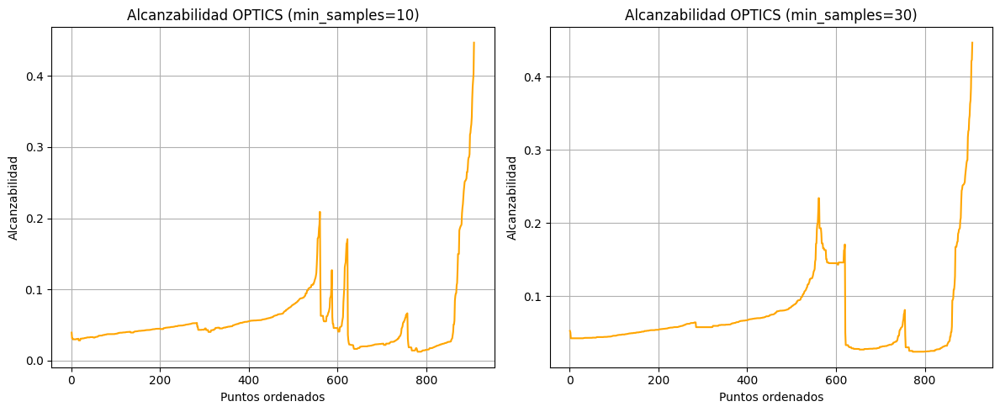

In [37]:
# Creación de los subplots
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(12, 5))

ax = ax.flatten()

espacio = np.arange(len(X))

# Primer subplot
ax[0].plot(espacio, optics_10.reachability_[order_optics_10], color='orange', zorder=2)
ax[0].set_title("Alcanzabilidad OPTICS (min_samples=10)")
ax[0].set_xlabel("Puntos ordenados")
ax[0].set_ylabel("Alcanzabilidad")
ax[0].grid(True, zorder=1)

# Segundo subplot
ax[1].plot(espacio, optics_30.reachability_[order_optics_30], color='orange', zorder=2)
ax[1].set_title("Alcanzabilidad OPTICS (min_samples=30)")
ax[1].set_xlabel("Puntos ordenados")
ax[1].set_ylabel("Alcanzabilidad")
ax[1].grid(True, zorder=1)

plt.tight_layout()
plt.show()

A partir de este gráfico, hemos determinado:
- `min_samples=10`:
    - 1 cluster grande.
    - 5 cluster de tamaño pequeño.
- `min_samples=30`:
    - 1 cluster grande.
    - 2 cluster de tamaño medio.
    - 1 cluster de tamaño pequeño. 

Como `OPTICS` calcula la distancia entre los puntos `eps`, este resultado se ha producido porque el algoritmo ha sido capaz de identificar la distancia óptima entre los puntos. Si atendemeos al gráfico, los picos representan la separación entre clusteres y los valles la distancia entre ellos. Los clusteres no son uniformes y en total existen representados 6 clusteres. Para más detalle es mejor observar las trazas entre característicass, ya que en el gráfico de alcanzabilidad no se observa la separación entre los clusteres.

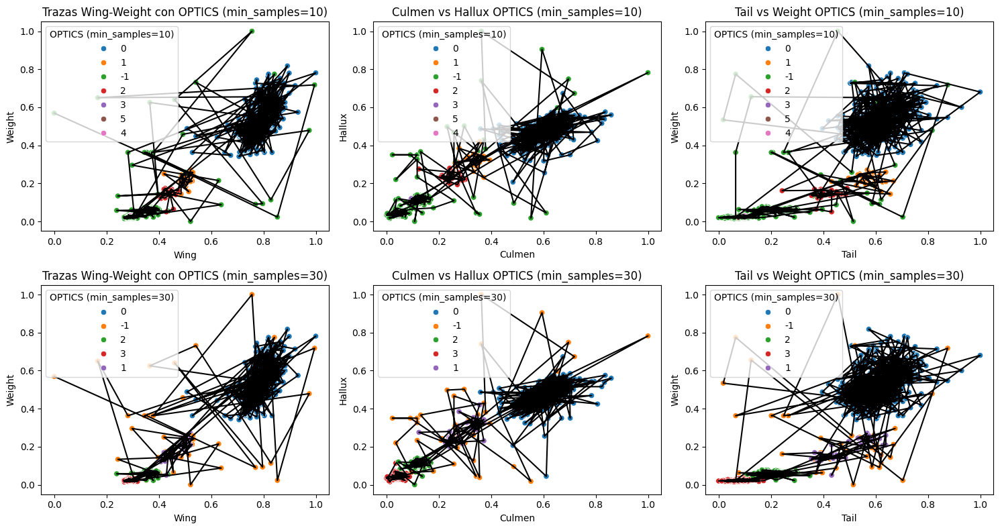

In [38]:

# Creación de los subplots
fig, ax = plt.subplots(nrows=2, ncols=3, figsize=(15, 8))

ax = ax.flatten()

# Primer subplot
sns.scatterplot(data=hawks_clean_df, x='Wing', y='Weight', hue='OPTICS (min_samples=10)', palette='tab10', ax=ax[0])
ax[0].plot(hawks_clean_df.loc[order_optics_10, 'Wing'], hawks_clean_df.loc[order_optics_10, 'Weight'], color='black')
ax[0].set_title("Trazas Wing-Weight con OPTICS (min_samples=10)")
ax[0].set_xlabel("Wing")
ax[0].set_ylabel("Weight")


# Segundo subplot
sns.scatterplot(data=hawks_clean_df, x='Culmen', y='Hallux', hue='OPTICS (min_samples=10)', palette='tab10', ax=ax[1])
ax[1].plot(hawks_clean_df.loc[order_optics_10, 'Culmen'], hawks_clean_df.loc[order_optics_10, 'Hallux'], color='black')
ax[1].set_title("Culmen vs Hallux OPTICS (min_samples=10)")
ax[1].set_xlabel("Culmen")
ax[1].set_ylabel("Hallux")

# Tercer subplot
sns.scatterplot(data=hawks_clean_df, x='Tail', y='Weight', hue='OPTICS (min_samples=10)', palette='tab10', ax=ax[2])
ax[2].plot(hawks_clean_df.loc[order_optics_10, 'Tail'], hawks_clean_df.loc[order_optics_10, 'Weight'], color='black')
ax[2].set_title("Tail vs Weight OPTICS (min_samples=10)")
ax[2].set_xlabel("Tail")
ax[2].set_ylabel("Weight")

# Cuarto subplot
sns.scatterplot(data=hawks_clean_df, x='Wing', y='Weight', hue='OPTICS (min_samples=30)', palette='tab10', ax=ax[3])
ax[3].plot(hawks_clean_df.loc[order_optics_30, 'Wing'], hawks_clean_df.loc[order_optics_30, 'Weight'], color='black')
ax[3].set_title("Trazas Wing-Weight con OPTICS (min_samples=30)")
ax[3].set_xlabel("Wing")
ax[3].set_ylabel("Weight")

# Quinto subplot
sns.scatterplot(data=hawks_clean_df, x='Culmen', y='Hallux', hue='OPTICS (min_samples=30)', palette='tab10', ax=ax[4])
ax[4].plot(hawks_clean_df.loc[order_optics_30, 'Culmen'], hawks_clean_df.loc[order_optics_30, 'Hallux'], color='black')
ax[4].set_title("Culmen vs Hallux OPTICS (min_samples=30)")
ax[4].set_xlabel("Culmen")
ax[4].set_ylabel("Hallux")

# Sexto subplot
sns.scatterplot(data=hawks_clean_df, x='Tail', y='Weight', hue='OPTICS (min_samples=30)', palette='tab10', ax=ax[5])
ax[5].plot(hawks_clean_df.loc[order_optics_30, 'Tail'], hawks_clean_df.loc[order_optics_30, 'Weight'], color='black')
ax[5].set_title("Tail vs Weight OPTICS (min_samples=30)")
ax[5].set_xlabel("Tail")
ax[5].set_ylabel("Weight")

plt.tight_layout()
plt.show()


Si representamos los PCA según los resultados de `OPTICS`:

In [39]:
fig = make_subplots(
    rows=1, 
    cols=3,
    specs=[
        [{'type': 'scene'}, {'type': 'scene'},{'type': 'scene'}],
        ],
    subplot_titles=(
        "PCA por Especie",
        "PCA por OPTICS (min_samples=10)",
        "PCA por OPTICS (min_samples=30)"
    ),
    horizontal_spacing=0.15
)

# Primer subplot (mostrar leyenda)
add_traces(fig, hawks_clean_df, 'PCA1', 'PCA2', 'PCA3', 'Species', 1, 1, show_legend=True)
# Agregar trazas de los clusters (k=3) para el primer subplot
add_traces(fig, hawks_clean_df, 'PCA1', 'PCA2', 'PCA3', 'OPTICS (min_samples=10)', 1, 2, show_legend=True)
add_traces(fig, hawks_clean_df, 'PCA1', 'PCA2', 'PCA3', 'OPTICS (min_samples=30)', 1, 3, show_legend=True)

# Configurar layout
fig.update_layout(
    title_text="Comparación PCA Original vs OPTICS 3D",
    legend=dict(
        title="Especies",
        itemsizing='constant',
        x=1.05,
        y=0.5,
        bgcolor='rgba(255,255,255,0.9)'
    ),
    margin=dict(r=200)
)

# Configurar ejes para columna izquierda (PCA1-PCA2-PCA3)
for row in [1, 2]:
    fig.update_scenes(
        xaxis_title='PCA1',
        yaxis_title='PCA2', 
        zaxis_title='PCA3',
        row=row, 
        col=1
    )

fig.show()

Podemos observar un gran número de valores outliers que no han sido correctamente clasificados y que están teniendo un impacto significativo en el modelo.

**Conclusiones:**
- El algoritmo `DBSCAN` ha sido capaz de identificar 3 grupos principales y 42 outliers, considerados como ruido (`-1` en el gráfico), aproximandose a los resultados originales
- El uso de un valor no óptimo de `eps` ha dado como resultado un número mayor de outliers y un número menor de grupos principales.
- El algoritmo `OPTICS` no ha sido capaz de identificar los 3 grupos principales, pero ha sido capaz de identificar 6 y más de 254 outlierss, considerados como ruido (`-1` en el gráfico), aproximandose a los resultados originales.
- En este caso hemos obtenido un resultado más preciso con `DBSCAN` que con `OPTICS`, ya que `OPTICS` ha sido capaz de identificar más outliers y no ha sido capaz de identificar los 3 grupos principales.
- Modificando el parámetro `min_samples` de `OPTICS` hemos podido observar que el número de clusters y outliers varía, pero no se ha obtenido un resultado similar al original.

# Ejercicio 3 <a class="anchor" id="ejercicio3"></a>

Realiza una comparativa de los métodos *k-means* y *DBSCAN*

## Respuesta 3 <a class="anchor" id="respuesta3"></a>

**Comparación de resultados con K-Means y DBSCAN**
- **K-Means**
    - Gracias a las mediciones realizadas hemos comprobado que los mejores clusteres para agrupar los datos son 2 o 3 clusteres.
    - Los valores outliers de cada grupo según hemos observado en la representación de los datos no están todos correctamente asociados y pueden mezclarse en otros grupos.
    - Utilizando distintas visualizaciones entre características en 2D y 3D además del uso de PCA hemos observado las diferencias entre el set de datos original y los resultados obtenidos por el algoritmo K-means.
- **DBSCAN**
    - Para hallar el mejor valor de `eps` hemos utilizado la metodología del codo, que nos ha dado un valor óptimo de `eps=0.15` para el número mínimo de puntos en un cluster.
    - El algoritmo DBSCAN ha sido capaz de identificar 3 grupos principales y 42 outliers, considerados como ruido (`-1` en el gráfico), aproximandose a los resultados originales.
    - El uso de un valor no óptimo de `eps` (`eps=0.25`) ha dado como resultado un menor número de outliers y un único grupo principal.
    


**Comparativa K-Means vs DBSCAN**

| **Característica**               | **K-Means**                                  | **DBSCAN**                                |
|------------------------------|----------------------------------------------|-------------------------------------------|
| **Tipo de algoritmo**         | **Particional**: Asigna puntos a clústeres.  | **Basado en densidad**: Agrupa puntos densos y marca como ruido los puntos dispersos. |
| **Número de clústeres**       | **Debe ser especificado** (`k` clústeres).   | **No necesita especificar el número de clústeres**. El número de clústeres es determinado automáticamente. |
| **Manejo de outliers**        | **Poco robusto**: Los outliers afectan mucho, ya que buscan la media de los puntos. | **Robusto frente a outliers**: Los puntos que no cumplen con el umbral de densidad se etiquetan como "ruido" (`-1`). |
| **Forma de los clústeres**    | **Esféricos**: Los clústeres tienden a ser de forma circular o esférica. | **Flexible**: Puede encontrar clústeres de cualquier forma (arbitraria). |
| **Escalabilidad**             | **Alta**: Es eficiente en grandes datasets, especialmente si se usa con inicialización eficiente como **K-Means++**. | **Menos eficiente** en grandes datasets, especialmente con alta dimensionalidad. |
| **Sensible a la escala de los datos** | **Sí**: Los resultados pueden cambiar si los datos no están escalados adecuadamente. | **Sí**: Depende de la métrica de distancia (`eps`), que puede verse afectada por la escala de las variables. |
| **Parámetros clave**          | **K**: El número de clústeres debe ser especificado. | **Eps** (distancia máxima entre puntos) y **min_samples** (número mínimo de puntos en un clúster). |
| **Manejo de clusters pequeños** | **No**: Los clústeres pequeños pueden ser absorbidos en el proceso. | **Sí**: Puede identificar clústeres pequeños y tratarlos como tales. |
| **Tiempos de ejecución**      | **Rápido**: Debido a su naturaleza basada en la optimización de la media. | **Lento**: Si los datos son grandes, puede ser computacionalmente más costoso, especialmente si no está bien ajustado. |
| **Ventaja principal**         | **Rápido y sencillo**: Buen rendimiento cuando los datos son relativamente homogéneos. | **Robusto a outliers**: Puede detectar clústeres de formas no esféricas y maneja ruido eficientemente. |
| **Desventajas**               | **Requiere definir `k`**: No es bueno con clústeres de forma irregular. | **Sensible a la elección de `eps` y `min_samples`**: Si los parámetros no son adecuados, los resultados pueden no ser útiles. |

**¿Cuándo usar cada uno?**
- **K-Means**:
    - Cuando los clústeres son esféricos
    - El dataset es grando y con pocos outliers
    - Los datos están bien escalados y normalizados
    - (IDEAL) Cuando se conoce el número de clústeres
- **DBSCAN**:
    - Cuando los clústeres tienen formas arbitrarias
    - Cuando hay un gran número de outliers
    - Cuando no se conoce el número de clústeres
    - Cuando queremos tener una mayor tolerancia a clústeres más pequeños y que estos no sean absorbidos en por el proceso como ocurre en K-Means.

**Conclusiones Finales**
- Ambos algoritmos tienen sus ventajas y desventajas, y la elección entre ellos depende del tipo de datos y del problema específico que se esté abordando.
- K-Means es más adecuado para datos homogéneos y cuando se conoce el número de clústeres, mientras que DBSCAN es más robusto frente a outliers y puede identificar clústeres de forma arbitraria.
- Para este dataset, DBSCAN es más adecuado, ya que los datos no son homogéneos y existen un gran número de outliers. Sin embargo, K-Means también ha sido capaz de identificar patrones en los datos y ha dado resultados similares a DBSCAN.
- En general, es recomendable probar ambos algoritmos y comparar los resultados obtenidos para determinar cuál es el más adecuado para el problema específico que se está abordando.

# Bibliografía <a class="anchor" id="bibliografia"></a>
- [Hawks Dataset](https://rdrr.io/rforge/Stat2Data/man/Hawks.html) 
- [rpy2 - R in Python](https://rpy2.github.io/)
- [Matplotlib](https://matplotlib.org/)
- [Seaborn](https://seaborn.pydata.org/)
- [Plotly](https://plotly.com/graphing-libraries/)
- [Pandas](https://pandas.pydata.org/)
- [Scikit-learn](https://scikit-learn.org/stable/index.html)
- [Scikit-learn Clustering](https://scikit-learn.org/stable/modules/clustering.html)
- [Scikit-learn PCA](https://scikit-learn.org/stable/modules/decomposition.html#pca)
- [Scikit-learn Imputation](https://scikit-learn.org/stable/modules/impute.html#impute)
- [Scikit-learn MinMaxScaler API](https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.MinMaxScaler.html)
- [Scikit-learn SimpleImputer API](https://scikit-learn.org/stable/modules/generated/sklearn.impute.SimpleImputer.html)
- [Scikit-learn PCA API](https://scikit-learn.org/stable/modules/generated/sklearn.decomposition.PCA.html)
- [Scikit-learn KMeans API](https://scikit-learn.org/stable/modules/generated/sklearn.cluster.KMeans.html#sklearn.cluster.KMeans)
- [Scikit-learn DBSCAN API](https://scikit-learn.org/stable/modules/generated/sklearn.cluster.DBSCAN.html)
- [Scikit-learn OPTICS API](https://scikit-learn.org/stable/modules/generated/sklearn.cluster.DBSCAN.html)
- [Unsupervised methods in machine learning by Anton Barrera Mora](https://rpubs.com/Kamaranis/unsupervised_methods)